# Classification :

In [2]:
%pip install seaborn
%pip install tabulate

In [3]:

from tabulate import tabulate


# assign data
mydata = [
    ["1", "after delete Education outlayers","Gini index: 0.46825396825396826 \nEntropy: 0.46017699115044247","Gini index: 0.5333333333333333 \nEntropy: 0.4666666666666667","Gini index: 0.5789473684210527 \nEntropy: 0.6052631578947368","true"], 
    ["2", "after applay Discretization before Normalization ","Gini index: 0.5132743362831859 \nEntropy:  0.37168141592920356","#Gini index: 0.41333333333333333 \nEntropy: 0.38666666666666666 ","Gini index: 0.3684210526315789 \nEntropy: 0.5263157894736842",""], 
    ["3", "after select 8 features","Gini index: 0.4336283185840708 \nEntropy: 0.4247787610619469","Gini index: 0.32 \nEntropy: 0.30666666666666664","Gini index: 0.3684210526315789 \nEntropy: 0.3684210526315789",""]]
Entropy: 0.5263157894736842
 
# create header
head = ["try number", "changes","Accuracy 30%","Accuracy 20%","Accuracy 10%","chosen"]
 
# display table
print(tabulate(mydata, headers=head, tablefmt="fancy_grid"))

╒══════════════╤══════════════════════════════════════════════════╤══════════════════════════════════╤═══════════════════════════════════╤═════════════════════════════════╤══════════╕
│   try number │ changes                                          │ Accuracy 30%                     │ Accuracy 20%                      │ Accuracy 10%                    │ chosen   │
╞══════════════╪══════════════════════════════════════════════════╪══════════════════════════════════╪═══════════════════════════════════╪═════════════════════════════════╪══════════╡
│            1 │ after delete Education outlayers                 │ Gini index: 0.46825396825396826  │ Gini index: 0.5333333333333333    │ Gini index: 0.5789473684210527  │ true     │
│              │                                                  │ Entropy: 0.46017699115044247     │ Entropy: 0.4666666666666667       │ Entropy: 0.6052631578947368     │          │
├──────────────┼──────────────────────────────────────────────────┼─────────────

In [4]:
import pandas as pd
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split 
from sklearn import metrics

<hr>
<br>

#### Reading the preprocessed dataset :

<br>
 <hr>

In [5]:
# Load data

df = pd.read_csv("../IT326 Project/processed_Data.csv")
display (df)

,Diabetes_012,HighBP,HighChol,CholCheck,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,AnyHealthcare,NoDocbcCost,GenHlth,DiffWalk,Sex,Age,Education,Discretized_BMI
0,0,1,1,1,1,0,0,0,0,1,1,0,5,1,0,9,4,5
1,0,0,0,0,1,0,0,1,0,0,0,1,3,0,0,7,6,1
2,0,1,1,1,0,0,0,0,1,0,1,1,5,1,0,9,4,2
3,0,1,0,1,0,0,0,1,1,1,1,0,2,0,0,11,3,2
4,0,1,1,1,0,0,0,1,1,1,1,0,2,0,0,11,5,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
370,2,0,1,1,1,0,0,1,0,0,1,0,3,0,1,10,3,4
371,2,1,0,1,0,0,0,0,0,0,1,0,4,0,0,8,4,5
372,2,1,1,1,0,0,1,1,1,1,1,1,3,0,0,7,4,1
373,2,1,0,1,0,0,0,0,1,0,1,0,3,1,0,10,5,4


<hr>

## Model Training and Evaluation:

#### we Split our dataset into features (X) and the target variable (y). Then Defined different partition sizes for splitting the data into training and test sets.
<br>


In [6]:

fn = df.keys().tolist()[1:]  
X = df[fn]  # Features
y = df['Diabetes_012'] 
print (fn)


['HighBP', 'HighChol', 'CholCheck', 'Smoker', 'Stroke', 'HeartDiseaseorAttack', 'PhysActivity', 'Fruits', 'Veggies', 'AnyHealthcare', 'NoDocbcCost', 'GenHlth', 'DiffWalk', 'Sex', 'Age', 'Education', 'Discretized_BMI']


<hr>
<br>

#### we trained decision tree classifiers (clf_gini, clf_entropy, etc.) with different attribute selection measures (gini index and entropy) on different partition sizes of the data.
 #### - The partition sizes used were 10% Test 90% Train , 20% Test 80% Train , and 30% Test 70% Train.
<br>


In [7]:

from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split

# Split the dataset into training and test sets with different partition sizes

X_train_large, X_test_large, y_train_large, y_test_large = train_test_split(X, y, test_size=0.3, random_state=32)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=32) 
X_train_small, X_test_small, y_train_small, y_test_small = train_test_split(X, y, test_size=0.1, random_state=32)  

# Create decision tree classifiers with different attribute selection measures
clf_ginil = DecisionTreeClassifier()
clf_entropyl = DecisionTreeClassifier(criterion="entropy")

clf_gini = DecisionTreeClassifier()
clf_entropy = DecisionTreeClassifier(criterion="entropy")

clf_ginis = DecisionTreeClassifier()
clf_entropys = DecisionTreeClassifier(criterion="entropy")

<hr>
<br>

## Gini Index:
####  Evaluated the models' performance using accuracy scores and confusion matrices on All test data partition using Gini Index.
<br>


30% Test Accuracy using Gini index: 0.415929203539823
20% Test Accuracy using Gini index: 0.4666666666666667
10% Test Accuracy using Gini index: 0.5


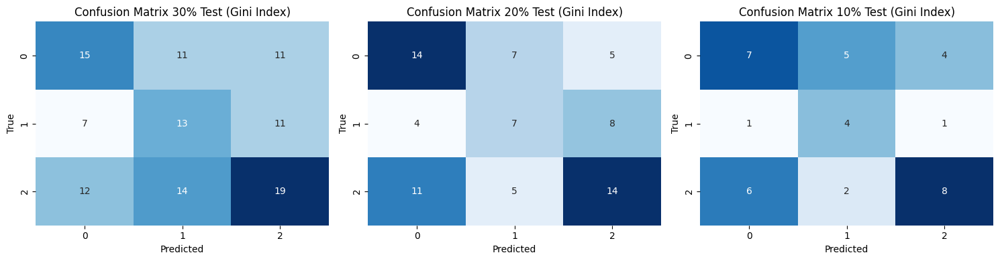

In [11]:
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Train the classifiers

# Classifier 1: clf_ginil
clf_ginil.fit(X_train_large, y_train_large)
y_pred_ginil = clf_ginil.predict(X_test_large)
accuracy_ginil = accuracy_score(y_test_large, y_pred_ginil)
print("30% Test Accuracy using Gini index:", accuracy_ginil)
cm_ginil = confusion_matrix(y_test_large, y_pred_ginil)


# Classifier 2: clf_gini
clf_gini.fit(X_train, y_train)
y_pred_gini = clf_gini.predict(X_test)
accuracy_gini = accuracy_score(y_test, y_pred_gini)
print("20% Test Accuracy using Gini index:", accuracy_gini)
cm_gini = confusion_matrix(y_test, y_pred_gini)


# Classifier 3: clf_ginis
clf_ginis.fit(X_train_small, y_train_small)
y_pred_ginis = clf_ginis.predict(X_test_small)
accuracy_ginis = accuracy_score(y_test_small, y_pred_ginis)
print("10% Test Accuracy using Gini index:", accuracy_ginis)
cm_ginis = confusion_matrix(y_test_small, y_pred_ginis)


# Visualize the confusion matrices
plt.figure(figsize=(15, 4))

# Confusion Matrix 30% Test (Gini Index)
plt.subplot(1, 3, 1)
sns.heatmap(cm_ginil, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix 30% Test (Gini Index)")
plt.xlabel("Predicted")
plt.ylabel("True")

# Confusion Matrix 20% Test (Gini Index)
plt.subplot(1, 3, 2)
sns.heatmap(cm_gini, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix 20% Test (Gini Index)")
plt.xlabel("Predicted")
plt.ylabel("True")

# Confusion Matrix 10% Test (Gini Index)
plt.subplot(1, 3, 3)
sns.heatmap(cm_ginis, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix 10% Test (Gini Index)")
plt.xlabel("Predicted")
plt.ylabel("True")

plt.tight_layout()
plt.show()



<br>


### Gini Index Analysis:

- The partition sizes used were 10%, 20%, and 30%.

- The highest accuracy achieved with the Gini index was 50% for a partition size of 10%.

Thus, among the sizes tested, the best partition size for the Gini index was 10%.

<br>



<hr>
<br>

#### Visualized decision tree using tree.plot_tree for 30% partition :
<br>
<hr>

In [12]:
from sklearn import tree
fig, axes = plt.subplots( figsize=(200, 50) )
tree.plot_tree(clf_ginil,feature_names=df.columns[1:],  
               filled=True,fontsize=15);
fig.savefig('decision_treeclf_ginil.png')

<hr>
<br>

#### Visualized decision tree using tree.plot_tree for 20% partition :
<br>
<hr>

In [13]:
fig, axes = plt.subplots( figsize=(200, 50) )
tree.plot_tree(clf_gini,feature_names=df.columns[1:],  
               filled=True,fontsize=15);
fig.savefig('decision_treeclf_ginii.png')

<hr>
<br>

#### Visualized decision tree using tree.plot_tree for 10% partition :
<br>
<hr>

In [14]:
fig, axes = plt.subplots( figsize=(200, 50) )
tree.plot_tree(clf_ginis,feature_names=df.columns[1:],  
               filled=True,fontsize=15);
fig.savefig('decision_treeclf_ginis1.png')

<hr>
<br>

## Information Gain (Entropy):
####  Evaluated the models' performance using accuracy scores and confusion matrices on All test data partition using entropy.
    
<br>
<hr>

 Test 30%  Accuracy using Entropy: 0.4778761061946903
 Test 20% Accuracy using Entropy: 0.44
 Test 10% Accuracy using Entropy: 0.6052631578947368


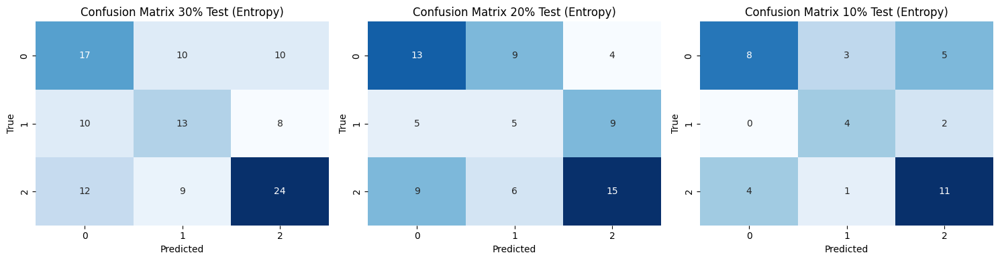

In [39]:
from sklearn.metrics import ConfusionMatrixDisplay
from sklearn.metrics import accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Train the classifiers

clf_entropyl.fit(X_train_large, y_train_large)
y_pred_entropy = clf_entropyl.predict(X_test_large)
accuracy_entropy = accuracy_score(y_test_large, y_pred_entropy)
print(" Test 30%  Accuracy using Entropy:", accuracy_entropy)
cm_entropyl = confusion_matrix(y_test_large, y_pred_entropy)



# Classifier 2: clf_gini
clf_entropy.fit(X_train, y_train)
y_pred_entropy = clf_entropy.predict(X_test)
accuracy_entropy = accuracy_score(y_test, y_pred_entropy)
print(" Test 20% Accuracy using Entropy:", accuracy_entropy)
cm_entropy = confusion_matrix(y_test, y_pred_entropy)



# Classifier 3: clf_ginis
clf_entropys.fit(X_train_small, y_train_small)
y_pred_entropy = clf_entropys.predict(X_test_small)
accuracy_entropy = accuracy_score(y_test_small, y_pred_entropy)
print(" Test 10% Accuracy using Entropy:", accuracy_entropy)
cm_entropys = confusion_matrix(y_test_small, y_pred_entropy)



# Visualize the confusion matrices
plt.figure(figsize=(15, 4))

# Confusion Matrix 30% Test (Gini Index)
plt.subplot(1, 3, 1)
sns.heatmap(cm_entropyl, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix 30% Test (Entropy)")
plt.xlabel("Predicted")
plt.ylabel("True")

# Confusion Matrix 20% Test (Gini Index)
plt.subplot(1, 3, 2)
sns.heatmap(cm_entropy, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix 20% Test (Entropy)")
plt.xlabel("Predicted")
plt.ylabel("True")

# Confusion Matrix 10% Test (Gini Index)
plt.subplot(1, 3, 3)
sns.heatmap(cm_entropys, annot=True, cmap="Blues", fmt="d", cbar=False)
plt.title("Confusion Matrix 10% Test (Entropy)")
plt.xlabel("Predicted")
plt.ylabel("True")

plt.tight_layout()
plt.show()



<br>

### Entropy Analysis:
- Similarly, the partition sizes used were 10%, 20%, and 30%.

- The highest accuracy achieved with entropy was 60.5% for a partition size of 10%.

Therefore, the best partition size for entropy, based on the highest accuracy, was also 10%.

<br>
<hr>

<hr>
<br>

#### Visualized decision tree using tree.plot_tree for 30% partition :
<br>


In [40]:
fig, axes = plt.subplots( figsize=(200, 50) )
tree.plot_tree(clf_entropyl,feature_names=df.columns[1:],  
               filled=True,fontsize=15);
fig.savefig('decision_treeclf_entropylarge.png')

<hr>
<br>

#### Visualized decision tree using tree.plot_tree for 20% partition :

<br>


In [41]:
fig, axes = plt.subplots( figsize=(200, 50) )
tree.plot_tree(clf_entropy,feature_names=df.columns[1:],  
               filled=True,fontsize=15);
fig.savefig('decision_treeclf_entropym.png')


<hr>
<br>

#### Visualized decision tree using tree.plot_tree for 10% partition :
<br>


In [42]:
fig, axes = plt.subplots( figsize=(200, 50) )
tree.plot_tree(clf_entropys,feature_names=df.columns[1:],  
               filled=True,fontsize=15);
fig.savefig('decision_treeclf_entropys.png')

<hr>
<br>

### Comparison between Gini Index and Entropy:

- Both the Gini index and entropy were tested with partition sizes of 10%, 20%, and 30%.

- For the partition size of 10%, entropy outperformed the Gini index, achieving an accuracy of 60.5% compared to 50%.

In general, entropy tended to yield higher accuracies across all partition sizes tested.

<br>
<hr>

<hr>
<br>

## Line Chart :
#### we use line chart to show a summary of accuracy scores for each partition size and attribute selection measures, with visualizes the accuracy versus partition size.

<br>    


Partition Size: 0.1, Criterion: entropy, Accuracy: 0.6052631578947368
Partition Size: 0.1, Criterion: gini, Accuracy: 0.5
Partition Size: 0.2, Criterion: entropy, Accuracy: 0.44
Partition Size: 0.2, Criterion: gini, Accuracy: 0.48
Partition Size: 0.3, Criterion: entropy, Accuracy: 0.46017699115044247
Partition Size: 0.3, Criterion: gini, Accuracy: 0.3805309734513274


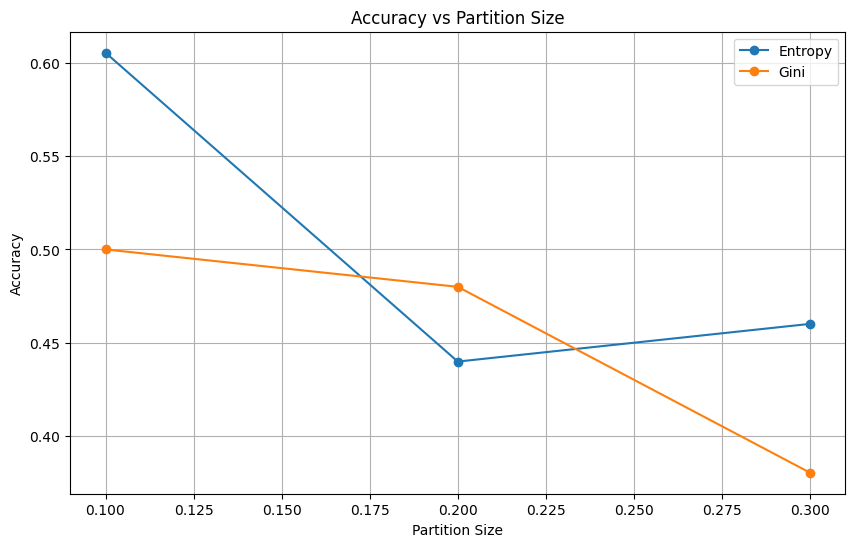

In [43]:
partition_sizes = [0.1, 0.2, 0.3]

criterions = ["entropy", "gini"]

results = {}

for size in partition_sizes:
    for criterion in criterions:
        
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=size, random_state=32)

        clf = DecisionTreeClassifier(criterion=criterion, random_state=32)
        
        clf.fit(X_train, y_train)
        
        y_pred = clf.predict(X_test)
        
        accuracy = accuracy_score(y_test, y_pred)
        
        results[(size, criterion)] = accuracy

for (size, criterion), accuracy in results.items():
    print(f"Partition Size: {size}, Criterion: {criterion}, Accuracy: {accuracy}")

sizes_entropy = [size for size, criterion in results if criterion == "entropy"]
accuracies_entropy = [results[(size, "entropy")] for size in sizes_entropy]
sizes_gini = [size for size, criterion in results if criterion == "gini"]
accuracies_gini = [results[(size, "gini")] for size in sizes_gini]

plt.figure(figsize=(10, 6))
plt.plot(sizes_entropy, accuracies_entropy, marker='o', label='Entropy')
plt.plot(sizes_gini, accuracies_gini, marker='o', label='Gini')
plt.title('Accuracy vs Partition Size')
plt.xlabel('Partition Size')
plt.ylabel('Accuracy')
plt.legend()
plt.grid(True)
plt.show()

### Analysis:
- compared the performance of classifiers with different attribute selection measures (gini index vs. entropy) on different partition sizes.

- Plotted accuracy against partition size for both entropy and gini index.

#### Observations:

It appears that the model's performance varies with the partition size and the criterion used for attribute selection measures. 
For example:

- The accuracy tends to decrease as the partition size increases for both entropy and gini index.

- Entropy seems to perform slightly better than gini for some partition sizes.

- The accuracy ranges from approximately 38% to 60.5% depending on the partition size and the measures.

 <hr> 


# Clustring :

In [44]:
%pip install kneed
%pip install yellowbrick 
%pip install seaborn
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
from sklearn.cluster import KMeans
from kneed import KneeLocator
from sklearn.pipeline import make_pipeline
from sklearn.metrics import silhouette_samples, silhouette_score 
from yellowbrick.cluster import SilhouetteVisualizer
import seaborn as sns
from sklearn.preprocessing import StandardScaler

In [45]:
df = pd.read_csv('processed_Data.csv')
df.head()

,Diabetes_012,HighBP,HighChol,CholCheck,Smoker,Stroke,HeartDiseaseorAttack,PhysActivity,Fruits,Veggies,AnyHealthcare,NoDocbcCost,GenHlth,DiffWalk,Sex,Age,Education,Discretized_BMI
0,0,1,1,1,1,0,0,0,0,1,1,0,5,1,0,9,4,5
1,0,0,0,0,1,0,0,1,0,0,0,1,3,0,0,7,6,1
2,0,1,1,1,0,0,0,0,1,0,1,1,5,1,0,9,4,2
3,0,1,0,1,0,0,0,1,1,1,1,0,2,0,0,11,3,2
4,0,1,1,1,0,0,0,1,1,1,1,0,2,0,0,11,5,1


In [46]:
features = df.drop(df.columns [0] ,axis= 1)
scaler = StandardScaler()
scaledfeatures = scaler.fit_transform(features)
df_scaled = pd.DataFrame(scaledfeatures,columns = features.columns)
print('scaled data frame')
print (df_scaled.head())

scaled data frame
     HighBP  HighChol  CholCheck    Smoker    Stroke  HeartDiseaseorAttack  \
0  0.698638  0.857969   0.116248  1.152906 -0.217913             -0.432098   
1 -1.431356 -1.165543  -8.602325  1.152906 -0.217913             -0.432098   
2  0.698638  0.857969   0.116248 -0.867373 -0.217913             -0.432098   
3  0.698638 -1.165543   0.116248 -0.867373 -0.217913             -0.432098   
4  0.698638  0.857969   0.116248 -0.867373 -0.217913             -0.432098   

   PhysActivity    Fruits   Veggies  AnyHealthcare  NoDocbcCost   GenHlth  \
0     -1.029776 -0.971085  0.578377       0.231021    -0.436436  1.953176   
1      0.971085 -0.971085 -1.728977      -4.328607     2.291288 -0.300489   
2     -1.029776  1.029776 -1.728977       0.231021     2.291288  1.953176   
3      0.971085  1.029776  0.578377       0.231021    -0.436436 -1.427321   
4      0.971085  1.029776  0.578377       0.231021    -0.436436 -1.427321   

   DiffWalk       Sex       Age  Education  Discre

##### here in this code we scaled the data bacause scaling the data before applying K-means clustering is crucial for ensuring fair representation of features, efficient convergence of the algorithm, and the production of high-quality clusters.


In [47]:
np.random.seed(42)

In [48]:
inertia_values = []
k_values = [2,3,4,5]
for k in k_values :
    Kmeans= make_pipeline(StandardScaler(),KMeans(n_clusters = k,random_state = 42 ,n_init=10))
    k_result =Kmeans.fit(df_scaled)
    inertia_values.append(Kmeans.named_steps['kmeans'].inertia_)

/lib/python3.11/site-packages/threadpoolctl.py:1019: RuntimeWarning: libc not found. The ctypes module in Python 3.11 is maybe too old for this OS.
  warnings.warn(


findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Arial, Liberation Sans, Bitstream Vera Sans, sans-serif


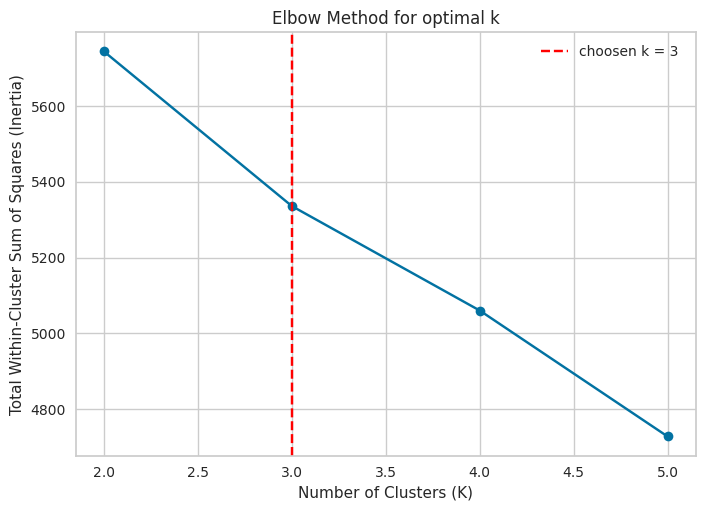

In [49]:
plt.plot(k_values,inertia_values , marker = 'o' )
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Total Within-Cluster Sum of Squares (Inertia)')
plt.title('Elbow Method for optimal k')
plt.axvline(x= 3 , linestyle = '--', color = 'red', label = 'choosen k = 3 ')
plt.legend()
plt.show()

##### After examining the plot, I noticed a significant decrease in inertia as the number of clusters increased from 2 to 3,the decrease in inertia became less pronounced. so, I Choose K=3 as the elbow point, indicating that adding more clusters wouldn't significantly reduce the inertia.

In [50]:
# Perform k-means clustering with different values of k
k_values = [2,3,4,5]
silhouette_avg_values = []
for k in k_values:
  kmeans = KMeans(n_clusters=k, random_state=42,n_init=10 )
  kmeans_result = kmeans.fit(df_scaled)
  silhouette_avg = silhouette_score(df_scaled, kmeans_result.labels_)
  silhouette_avg_values.append(silhouette_avg)


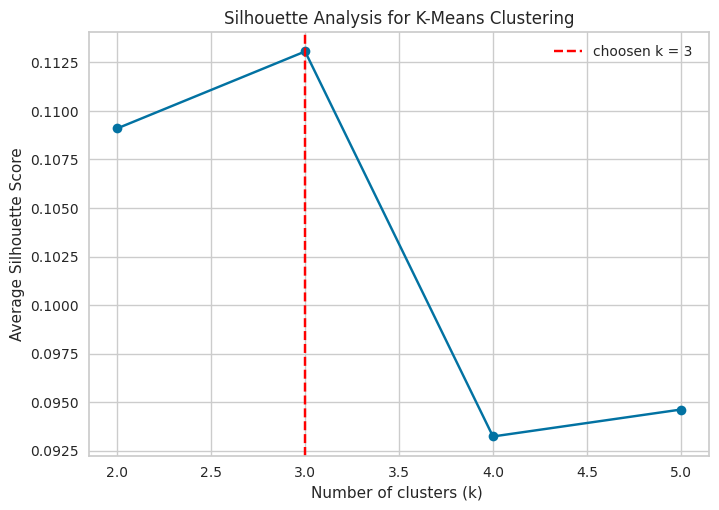

In [51]:
# Plot the silhouette scores for different values of k
plt.plot(k_values, silhouette_avg_values, marker='o')
plt.title('Silhouette Analysis for K-Means Clustering') 
plt.xlabel( 'Number of clusters (k) ') 
plt.ylabel( 'Average Silhouette Score')
plt.axvline(x= 3 , linestyle = '--', color = 'red', label = 'choosen k = 3 ')
plt.legend()
plt.show()

##### In this case, I observed that the average silhouette score was highest when k =3 compared to other values of K [2,4,5], so I choose  K=3 as it represents a configuration where the data points are most appropriately grouped into distinct clusters, maximizing both cohesion within clusters and separation between clusters.

/lib/python3.11/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


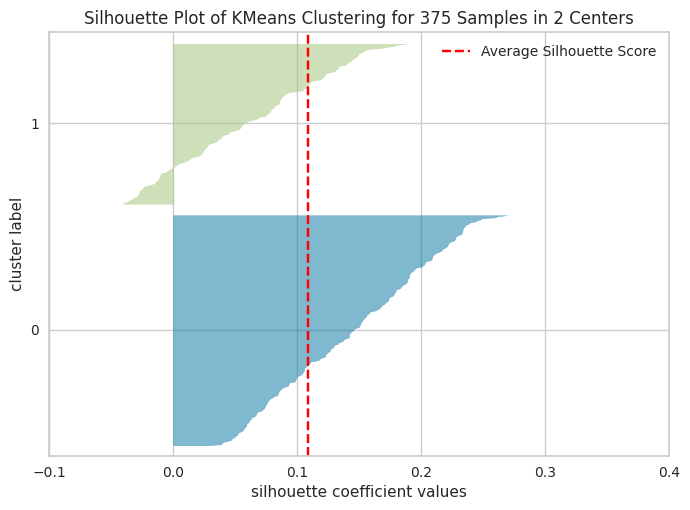

/lib/python3.11/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


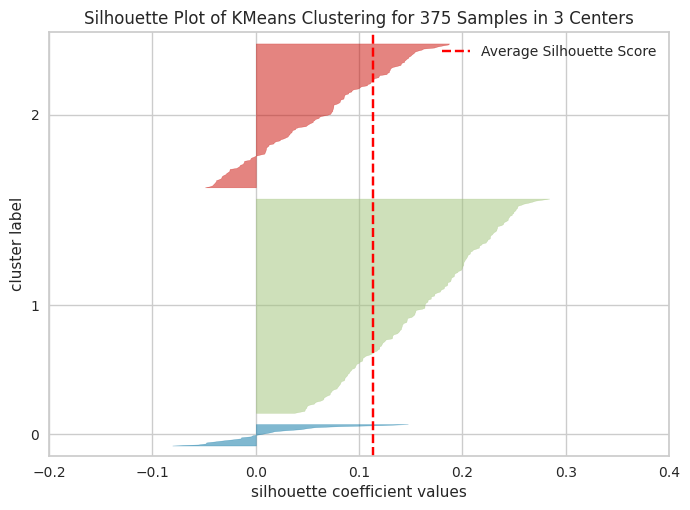

/lib/python3.11/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


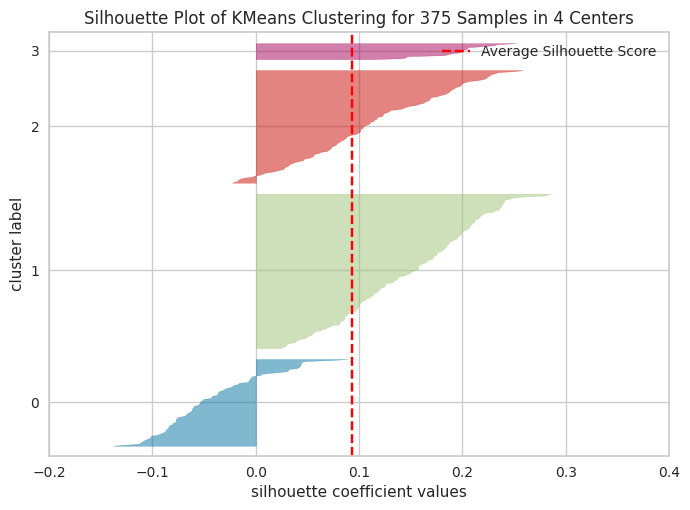

/lib/python3.11/site-packages/sklearn/base.py:465: UserWarning: X does not have valid feature names, but KMeans was fitted with feature names
  warnings.warn(


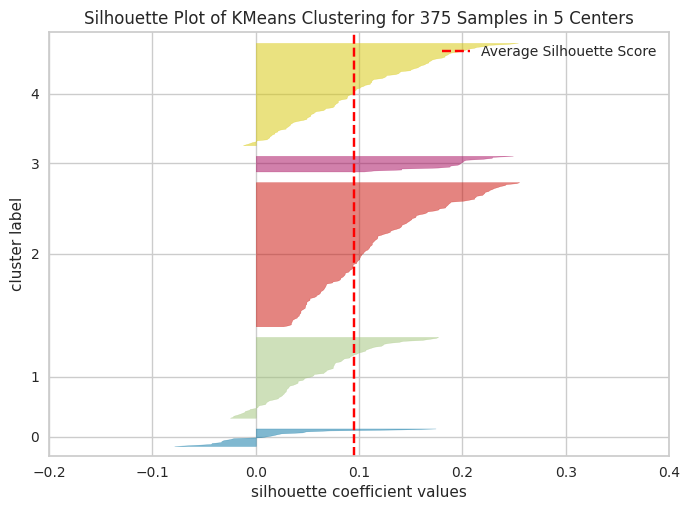

In [52]:
k_values = [2,3,4,5]
for k in k_values:
  kmeans = KMeans(n_clusters=k, random_state=42,n_init=10 )
  kmeans_result = kmeans.fit(df_scaled)
  visualizer = SilhouetteVisualizer(kmeans, colors = 'yellowbrick')
  visualizer.fit(df_scaled) 
  visualizer.show()

##### After analyzing the silhouette plots for different values of K, I observed that K=3 The silhouette plot showed The majority of data points had positive silhouette scores, indicating that they were appropriately assigned to their respective clusters. 

##### so the K= 3 appears to be the most appropriate choice for clustering the data, as it resulted in well-defined clusters with higher average silhouette scores.